### Experiment :
### Objectives

1. Train on embeddings and withou embeddinsgs
4. Error analysis 

### Observations

1. dropout rate increasing to 0.2 reduce the overfitting and increase overall performence
2. Eventhough TCN has showed to be promising result resul is not higer than RNN variants
3. Higest F1-score achived with w2v skip gram 0.7 
4. when reduce the complexity of model to from 12 to 64 and from  to 32 filters model performcence was less drasticaly

### Solutions and further investigation

1. Do proper hyperparameter tuning for number of TCN filters, kernel , dilation
2. 
3. 

### Load Modeules and datasets

In [1]:
import numpy as np
import random as rn
np.random.seed(0)
rn.seed(0)
import pandas as pd
import matplotlib.pyplot as plt
pd.set_option('display.max_colwidth', 1000)
# import helper function script
import sys
sys.path.insert(1,'G:\\Github\\Sinhala-Hate-Speech-Detection')
import utills
import TextClassifier


Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
def tcn_model(TC,kernel_size = 3, activation='relu'):
    

    from tcn import TCN, tcn_full_summary
    from tensorflow.python.keras.optimizer_v2.adam import Adam
    from tensorflow.keras.layers import Input, Embedding, Dense, Dropout, SpatialDropout1D
    from tensorflow.keras.layers import concatenate, GlobalAveragePooling1D, GlobalMaxPooling1D
    from tensorflow.keras.models import Model
    
    inp = Input( shape=(TC.MAX_SEQ_LEN,))
    if(TC.EMBEDDING == None):
        x = Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                        #weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable)(inp)
    else:
        x = Embedding(output_dim=TC.EMBEDDING_SIZE, 
                            input_dim=TC.LEN_VOCAB, 
                            input_length=TC.MAX_SEQ_LEN,
                            weights=[TC.emb_matrix], # Additionally we give the Wi
                            trainable=TC.trainable)(inp)
        
    x = SpatialDropout1D(0.2)(x)
    
    x = TCN(128,dilations = [1, 2, 4], return_sequences=True, activation = activation, name = 'tcn1')(x)
    x = TCN(64,dilations = [1, 2, 4], return_sequences=True, activation = activation, name = 'tcn2')(x)
    
    avg_pool = GlobalAveragePooling1D()(x)
    max_pool = GlobalMaxPooling1D()(x)
    
    conc = concatenate([avg_pool, max_pool])
    conc = Dense(16, activation="relu")(conc)
    conc = Dropout(0.2)(conc)
    outp = Dense(1, activation="sigmoid")(conc)    

    model = Model(inputs=inp, outputs=outp)
    optimizer_adam = Adam(learning_rate=TC.lr)
    model.compile(loss='binary_crossentropy',
                    optimizer=optimizer_adam,
                    metrics=['acc'])
    #model.compile( loss = 'binary_crossentropy', optimizer = 'adam', metrics = ['accuracy'])
    TC.model = model
    #tcn_full_summary(model)
    print(model.summary())
    return model

In [18]:
def predict_proba(arr,TC=TC_W):
    import numpy as np
    from tensorflow.python.keras.preprocessing import sequence
    pred=TC.model.predict(sequence.pad_sequences(TC.token.texts_to_sequences(arr),maxlen=TC.MAX_SEQ_LEN))
    returnable=[]
    for i in pred:
        temp=i[0]
        returnable.append(np.array([1-temp,temp]))
    return np.array(returnable)


def error_analysis(TC,model,Y_pred):
    import numpy as np
    from IPython.display import display
    import matplotlib.pyplot as plt
    import eli5
    from eli5.lime import TextExplainer
    import shap
    from lime.lime_text import LimeTextExplainer
    import tensorflow.compat.v1 as tf
    tf.disable_v2_behavior()
    from tensorflow.python.keras.preprocessing import sequence

    import tensorflow.keras.backend as K
    #token = Tokenizer(num_words=self.LEN_VOCAB)
    #token.fit_on_texts(self.X_tr)
    lime_explainer= LimeTextExplainer(class_names=[0,1])

    te = TextExplainer(random_state=0)
    distrib_samples = TC.X_train[:100]
    #explainer = shap.DeepExplainer(model, distrib_samples)
    # explain the first 25 predictions
    # explaining each prediction requires 2 * background dataset size runs
    # num_explanations = 25 #len(TC_F.X_test)
    # shap_values = explainer.shap_values(TC.X_test[:num_explanations])
    # shap.initjs()
    # num2word = {}
    arr_index=TC.X_te.index
    # for w in TC.word_index.keys():
    #     num2word[TC.word_index[w]] = w
    # x_test_words = np.stack([np.array(list(map(lambda x: num2word.get(x, "NONE"), TC.X_test[i]))) for i in range(num_explanations)])
    i=0
    
    for s in TC.X_te:
        if(i==21):
            break
        if(TC.Y_test[arr_index[i]] != Y_pred[i]):
            print(s)
            print("Predicted Label : ",TC.result_map(Y_pred[i])," | Turth Label : ",TC.result_map(TC.Y_test[arr_index[i]]))
            te.fit(TC.X_te[arr_index[i]],predict_proba)
            #shap.force_plot(explainer.expected_value[0], shap_values[0][i], x_test_words[i],matplotlib=True)
            display(te.show_prediction(target_names=[0,1]))
            display(lime_explainer.explain_instance(TC.X_te[arr_index[i]],predict_proba).show_in_notebook(text=True))
        i+=1
        print()

##### Fasttext trainable

In [6]:
TC_F = TextClassifier.TextClassifier(EMBEDDING='fasttext')

Load data

X train (4526,) Y train (4526,) X test (1940,) Y test (1940,)
Build vocab

Load Embedding model

Create embedding index

found 818830 word vectors
Check coverage
Found embeddings for 87.50% of vocab
Found embeddings for  96.39% of all text
Added 2197 words to embedding with rare words handling of fasttext
Check coverage
Found embeddings for 100.00% of vocab
Found embeddings for  100.00% of all text
dictionary size:  17577
Embedding matrix 



Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding_2 (Embedding)         (None, 100, 300)     6000000     input_3[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_26 (SpatialDr (None, 100, 300)     0           embedding_2[0][0]                
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 64)      138688      spatial_dropout1d_26[0][0]       
____________________________________________________________________________________________

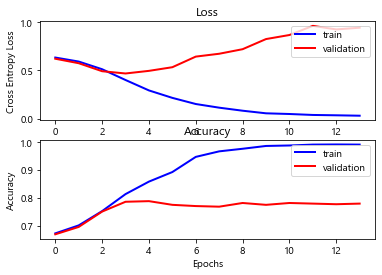

========= Eperiment -   TCN trainable fasttext lr-0.0001  =========


Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-479
              precision    recall  f1-score   support

           0       0.83      0.92      0.87      1336
           1       0.77      0.57      0.66       604

    accuracy                           0.81      1940
   macro avg       0.80      0.75      0.76      1940
weighted avg       0.81      0.81      0.80      1940

Predicted     0    1
Actual              
0          1230  106
1           258  346


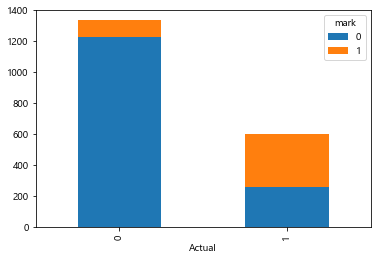

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට

In [10]:
# Fasttext dynamic embedding - tranable = True - changesd architecture
TC_F.EPOCHS =50
TC_F.BATCH_SIZE =16
TC_F.lr = 0.0001
TC_F.tag = " TCN trainable fasttext lr-0.0001"
TC_F.trainable = True
tcn_tf_model = tcn_model(TC_F)
tcn_tf_model,hist = TC_F.train_model(tcn_tf_model)
Y_pred = TC_F.model_evaluate(tcn_tf_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 100, 300)     6000000     input_2[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_13 (SpatialDr (None, 100, 300)     0           embedding_1[0][0]                
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 128)     400256      spatial_dropout1d_13[0][0]       
____________________________________________________________________________________________

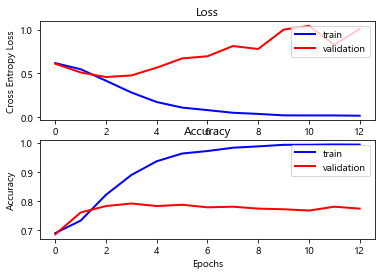

========= Eperiment -   TCN trainable fasttext lr-0.0001  =========


Info (NVML): NVML Shared Library Not Found. GPU usage metrics may not be reported. For more information, see https://docs-legacy.neptune.ai/logging-and-managing-experiment-results/logging-experiment-data.html#hardware-consumption 


https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-478
              precision    recall  f1-score   support

           0       0.84      0.89      0.87      1336
           1       0.72      0.63      0.67       604

    accuracy                           0.81      1940
   macro avg       0.78      0.76      0.77      1940
weighted avg       0.81      0.81      0.81      1940

Predicted     0    1
Actual              
0          1190  146
1           223  381


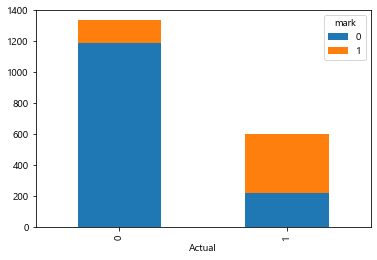

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ

In [8]:
# Fasttext dynamic embedding - tranable = True
TC_F.EPOCHS =50
TC_F.BATCH_SIZE =16
TC_F.lr = 0.0001
TC_F.tag = " TCN trainable fasttext lr-0.0001"
TC_F.trainable = True
tcn_tf_model = tcn_model(TC_F)
tcn_tf_model,hist = TC_F.train_model(tcn_tf_model)
Y_pred = TC_F.model_evaluate(tcn_tf_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

##### Fasttext

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding_2 (Embedding)         (None, 100, 300)     6000000     input_3[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_26 (SpatialDr (None, 100, 300)     0           embedding_2[0][0]                
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 128)     400256      spatial_dropout1d_26[0][0]       
____________________________________________________________________________________________

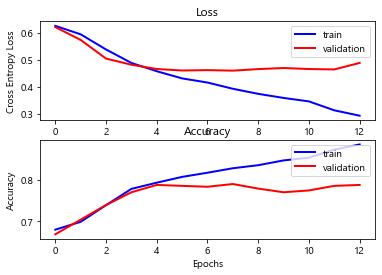

========= Eperiment -   TCN fasttext dropout 0.2  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-485
              precision    recall  f1-score   support

           0       0.84      0.88      0.86      1336
           1       0.70      0.63      0.67       604

    accuracy                           0.80      1940
   macro avg       0.77      0.76      0.76      1940
weighted avg       0.80      0.80      0.80      1940

Predicted     0    1
Actual              
0          1176  160
1           222  382


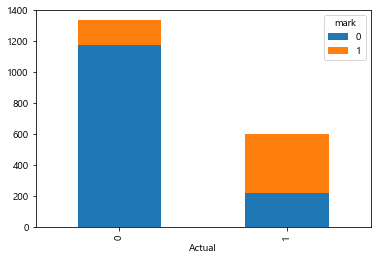

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\neptune\internal\threads\ping_thread.py", line 37, in run
    self.__backend.ping_experiment(self.__experiment)
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\neptune\internal\api_clients\hosted_api_clients\hosted_alpha_leaderboard_api_client.py", line 392, in ping_experiment
    self.leaderboard_swagger_client.api.ping(experimentId=str(experiment.internal_id)).response().result
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\bravado\client.py", line 279, in __call__
    request_config=request_config,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\bravado\requests_client.py", line 399, in request
    self.authenticated_request(sanitized_params),
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\bravado\requests_client.py", line 440, in authenticated_request
    return self.apply_authentication(requests.Request(**request_params))
  File "C:\Us

In [8]:
# increased dropout to 0.2
TC_F.EPOCHS =50
TC_F.BATCH_SIZE =16
TC_F.lr = 0.0001
TC_F.tag = " TCN fasttext dropout 0.2"
TC_F.trainable = False

tcn_f_model = tcn_model(TC_F)
tcn_f_model,hist = TC_F.train_model(tcn_f_model)
Y_pred = TC_F.model_evaluate(tcn_f_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

In [11]:
#simplified number of filters and increased dropout to 0.2
TC_F.EPOCHS =50
TC_F.BATCH_SIZE =16
TC_F.lr = 0.0001
TC_F.tag = " TCN fasttext 64 32 lr-0.0001"
TC_F.trainable = False

tcn_f_model = tcn_model(TC_F)
tcn_f_model,hist = TC_F.train_model(tcn_f_model)

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding_3 (Embedding)         (None, 100, 300)     6000000     input_4[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_39 (SpatialDr (None, 100, 300)     0           embedding_3[0][0]                
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 64)      138688      spatial_dropout1d_39[0][0]       
____________________________________________________________________________________________

train loss -  0.3926201176311503  train acc-  0.8261158
test loss -  0.4476453643484214  test acc-  0.8005155
Train acc: 0.826, Test acc: 0.801


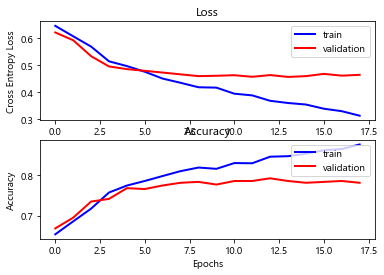

========= Eperiment -   TCN fasttext 64 32 lr-0.0001  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-480
              precision    recall  f1-score   support

           0       0.80      0.94      0.87      1336
           1       0.79      0.49      0.61       604

    accuracy                           0.80      1940
   macro avg       0.80      0.72      0.74      1940
weighted avg       0.80      0.80      0.79      1940

Predicted     0    1
Actual              
0          1255   81
1           306  298


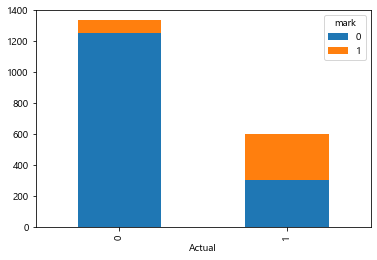

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ

In [12]:
Y_pred = TC_F.model_evaluate(tcn_f_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

train loss -  0.39665437877915677  train acc-  0.8320813
test loss -  0.4556159726737701  test acc-  0.8005155
Train acc: 0.832, Test acc: 0.801


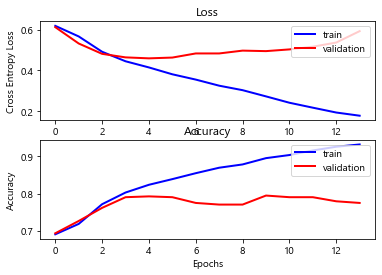

========= Eperiment -   TCN fasttext lr-0.0001  =========


Info (NVML): NVML Shared Library Not Found. GPU usage metrics may not be reported. For more information, see https://docs-legacy.neptune.ai/logging-and-managing-experiment-results/logging-experiment-data.html#hardware-consumption 


https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-474
              precision    recall  f1-score   support

           0       0.82      0.91      0.86      1336
           1       0.73      0.57      0.64       604

    accuracy                           0.80      1940
   macro avg       0.78      0.74      0.75      1940
weighted avg       0.79      0.80      0.79      1940

Predicted     0    1
Actual              
0          1211  125
1           262  342


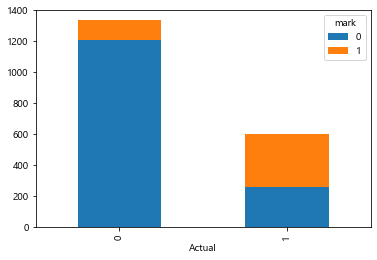

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ

In [9]:
# lr = 0.0001
Y_pred = TC_F.model_evaluate(tcn_f_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

In [ ]:
error_analysis(TC_F,tcn_f_model,Y_pred)

##### word2vec

In [3]:
TC_W = TextClassifier.TextClassifier(EMBEDDING='w2v_skipgram')

Load data

X train (4526,) Y train (4526,) X test (1940,) Y test (1940,)
Build vocab

Load Embedding model

Create embedding index

found 2137729 word vectors
Check coverage
Found embeddings for 93.59% of vocab
Found embeddings for  98.12% of all text
Added 489 words to embedding with longer suffix
Added 29 words to embedding with shorter suffix
2138247
Check coverage
Found embeddings for 96.54% of vocab
Found embeddings for  99.00% of all text
dictionary size:  17577
Embedding matrix 



Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 100, 300)     6000000     input_1[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d (SpatialDropo (None, 100, 300)     0           embedding[0][0]                  
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 128)     400256      spatial_dr

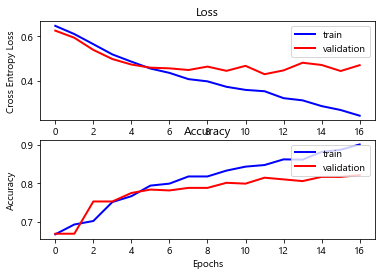

========= Eperiment -  TCN w2v skipgram dropout 0.2  =========


Info (NVML): NVML Shared Library Not Found. GPU usage metrics may not be reported. For more information, see https://docs-legacy.neptune.ai/logging-and-managing-experiment-results/logging-experiment-data.html#hardware-consumption 


https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-482
              precision    recall  f1-score   support

           0       0.85      0.92      0.88      1336
           1       0.79      0.64      0.70       604

    accuracy                           0.83      1940
   macro avg       0.82      0.78      0.79      1940
weighted avg       0.83      0.83      0.83      1940

Predicted     0    1
Actual              
0          1234  102
1           220  384


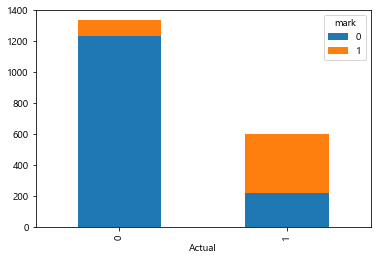

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට

In [4]:
# increase dropout to 0.2
TC_W.EPOCHS =50
TC_W.BATCH_SIZE =16
TC_W.lr = 0.0001
TC_W.tag = "TCN w2v skipgram dropout 0.2"
tcn_w_model = tcn_model(TC_W)
tcn_w_model, hist = TC_W.train_model(tcn_w_model)
Y_pred = TC_W.model_evaluate(tcn_w_model,hist)
TC_W.save_predictions(Y_pred,TC_W.tag)

In [15]:
TC_W.EPOCHS =50
TC_W.BATCH_SIZE =16
TC_W.lr = 0.0001
TC_W.tag = "TCN w2v skipgram lr-0.0001"
tcn_w_model = tcn_model(TC_W)
tcn_w_model, hist = TC_W.train_model(tcn_w_model)

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding_4 (Embedding)         (None, 100, 300)     6000000     input_5[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_52 (SpatialDr (None, 100, 300)     0           embedding_4[0][0]                
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 128)     400256      spatial_dropout1d_52[0][0]       
____________________________________________________________________________________________

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\contrib\pyopenssl.py", line 485, in wrap_socket
    cnx.do_handshake()
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\OpenSSL\SSL.py", line 1934, in do_handshake
    self._raise_ssl_error(self._ssl, result)
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\OpenSSL\SSL.py", line 1664, in _raise_ssl_error
    raise SysCallError(-1, "Unexpected EOF")
OpenSSL.SSL.SysCallError: (-1, 'Unexpected EOF')

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 376, in _make_request
    self._validate_conn(conn)
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 994, 


Epoch 00009: val_loss did not improve from 0.42695
4073/4073 - 44s - loss: 0.2946 - acc: 0.8807 - val_loss: 0.4367 - val_acc: 0.8013
Epoch 10/50

Epoch 00010: val_loss did not improve from 0.42695
4073/4073 - 35s - loss: 0.2714 - acc: 0.8954 - val_loss: 0.4557 - val_acc: 0.8102
Epoch 11/50

Epoch 00011: val_loss did not improve from 0.42695
4073/4073 - 34s - loss: 0.2392 - acc: 0.9047 - val_loss: 0.4774 - val_acc: 0.8057
Epoch 12/50

Epoch 00012: val_loss did not improve from 0.42695
4073/4073 - 31s - loss: 0.2168 - acc: 0.9170 - val_loss: 0.4748 - val_acc: 0.8079
Epoch 13/50

Epoch 00013: val_loss did not improve from 0.42695
4073/4073 - 28s - loss: 0.1844 - acc: 0.9347 - val_loss: 0.4793 - val_acc: 0.7991
Epoch 14/50

Epoch 00014: val_loss did not improve from 0.42695
4073/4073 - 30s - loss: 0.1654 - acc: 0.9413 - val_loss: 0.5078 - val_acc: 0.8013
Epoch 15/50

Epoch 00015: val_loss did not improve from 0.42695
4073/4073 - 30s - loss: 0.1538 - acc: 0.9470 - val_loss: 0.5950 - val_ac

train loss -  0.2969330737957426  train acc-  0.8879806
test loss -  0.39768493998910964  test acc-  0.83247423
Train acc: 0.888, Test acc: 0.832


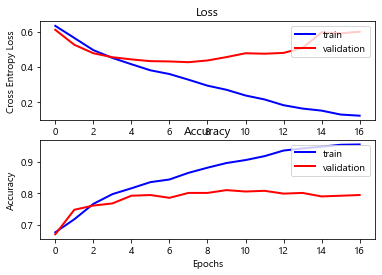

========= Eperiment -  TCN w2v skipgram lr-0.0001  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-476
              precision    recall  f1-score   support

           0       0.85      0.92      0.88      1336
           1       0.78      0.64      0.71       604

    accuracy                           0.83      1940
   macro avg       0.82      0.78      0.79      1940
weighted avg       0.83      0.83      0.83      1940

Predicted     0    1
Actual              
0          1226  110
1           215  389


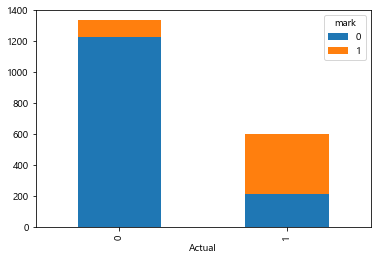

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

In [16]:
Y_pred = TC_W.model_evaluate(tcn_w_model,hist)
TC_W.save_predictions(Y_pred,TC_W.tag)

In [19]:
error_analysis(TC_W,tcn_w_model,Y_pred)




කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate


None


ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate


None


මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate


None


සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට් එකම එකම සෙල් එකට සෙට් උනොත් සිංදු කිය කිය පුක පෙන්නතැකි
Predicted Label :  Hate  | Turth Label :  Not Hate


None








ලොරි ඩ්‍රයිවර්ලා ඔක්කොම ඔහොම මෝඩ වැඩ තමය් කරන්නේ ඒගොල්ලන් ඉගනගැන නැති හින්ද නේ ඩ්‍රයිවර් කෙනෙක් වෙන්නේ
Predicted Label :  Not Hate  | Turth Label :  Hate


None

##### word2vec cbow

In [5]:
TC_W_2 = TextClassifier.TextClassifier(EMBEDDING='w2v_cbow')

Load data

X train (4526,) Y train (4526,) X test (1940,) Y test (1940,)
Build vocab

Load Embedding model

Create embedding index

found 2137729 word vectors
Check coverage
Found embeddings for 93.59% of vocab
Found embeddings for  98.12% of all text
Added 489 words to embedding with longer suffix
Added 29 words to embedding with shorter suffix
2138247
Check coverage
Found embeddings for 96.54% of vocab
Found embeddings for  99.00% of all text
dictionary size:  17577
Embedding matrix 



Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 100, 300)     6000000     input_2[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_13 (SpatialDr (None, 100, 300)     0           embedding_1[0][0]                
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 128)     400256      spatial_dropout1d_13[0][0]       
____________________________________________________________________________________________

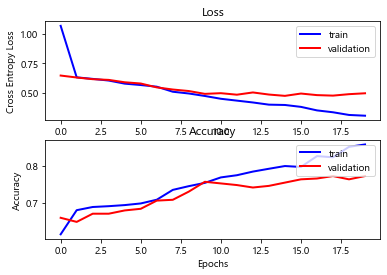

========= Eperiment -  TCN w2v cbow dropout 0.2  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-483
              precision    recall  f1-score   support

           0       0.81      0.92      0.86      1336
           1       0.74      0.53      0.62       604

    accuracy                           0.80      1940
   macro avg       0.78      0.72      0.74      1940
weighted avg       0.79      0.80      0.78      1940

Predicted     0    1
Actual              
0          1225  111
1           285  319


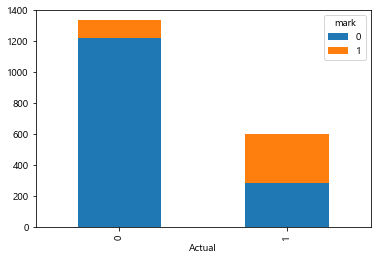

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

In [6]:
# dropout 0.2
TC_W_2.EPOCHS =50
TC_W_2.BATCH_SIZE =16
TC_W_2.lr = 0.0001
TC_W_2.tag = "TCN w2v cbow dropout 0.2"
tcn_w2_model = tcn_model(TC_W_2)

tcn_w2_model, hist = TC_W_2.train_model(tcn_w2_model)
Y_pred = TC_W_2.model_evaluate(tcn_w2_model,hist)
TC_W_2.save_predictions(Y_pred,TC_W_2.tag)

In [21]:
TC_W_2.EPOCHS =50
TC_W_2.BATCH_SIZE =16
TC_W_2.lr = 0.0001
TC_W_2.tag = "TCN w2v cbow lr-0.0001"
tcn_w2_model = tcn_model(TC_W_2)

tcn_w2_model, hist = TC_W_2.train_model(tcn_w2_model)

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding_5 (Embedding)         (None, 100, 300)     6000000     input_6[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_65 (SpatialDr (None, 100, 300)     0           embedding_5[0][0]                
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 128)     400256      spatial_dropout1d_65[0][0]       
____________________________________________________________________________________________

train loss -  0.2926640880092076  train acc-  0.9019001
test loss -  0.4790981811346467  test acc-  0.77577317
Train acc: 0.902, Test acc: 0.776


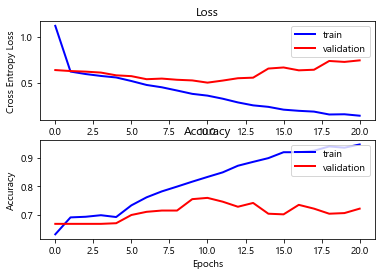

========= Eperiment -  TCN w2v cbow lr-0.0001  =========
https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-477
              precision    recall  f1-score   support

           0       0.80      0.90      0.85      1336
           1       0.70      0.49      0.58       604

    accuracy                           0.78      1940
   macro avg       0.75      0.70      0.71      1940
weighted avg       0.77      0.78      0.76      1940

Predicted     0    1
Actual              
0          1209  127
1           308  296


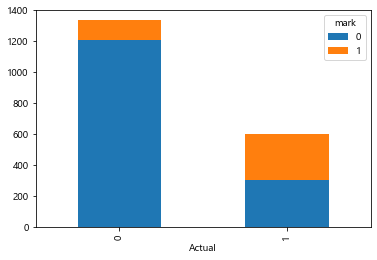

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ

In [22]:
Y_pred = TC_W_2.model_evaluate(tcn_w2_model,hist)
TC_W_2.save_predictions(Y_pred,TC_W_2.tag)

In [23]:
error_analysis(TC_W_2,tcn_w2_model,Y_pred)


ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate


None



කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate


None


ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate


None


මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate


None


සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට් එකම එකම සෙල් එකට සෙට් උනොත් සිංදු කිය කිය පුක පෙන්නතැකි
Predicted Label :  Hate  | Turth Label :  Not Hate


None



කෝ බං වන් ෂොට් වන් මම හිතුවෙ මිනිහා පස් හය දෙනෙකුට වඩාගෙන ගහයි කියලා
Predicted Label :  Hate  | Turth Label :  Not Hate


None






ලොරි ඩ්‍රයිවර්ලා ඔක්කොම ඔහොම මෝඩ වැඩ තමය් කරන්නේ ඒගොල්ලන් ඉගනගැන නැති හින්ද නේ ඩ්‍රයිවර් කෙනෙක් වෙන්නේ
Predicted Label :  Not Hate  | Turth Label :  Hate


None






මේ උතුම් පුණ්‍ය ශක්තීන්ගේ බලයෙන් මෙවැනි අකල් මරණයන්ට මතු ආත්මයන්හි ගොදුරු නොවේවා
Predicted Label :  Hate  | Turth Label :  Not Hate


None

##### Random embedding

In [3]:
TC = TextClassifier.TextClassifier(EMBEDDING=None)

Load data

X train (4526,) Y train (4526,) X test (1940,) Y test (1940,)
dictionary size:  17577


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 100, 300)     6000000     input_1[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d (SpatialDropo (None, 100, 300)     0           embedding[0][0]                  
__________________________________________________________________________________________________
tcn1 (TCN)                      (None, 100, 128)     400256      spatial_dr

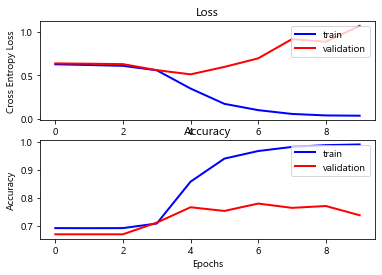

========= Eperiment -  TCN random emb lr 0.0001  =========


Info (NVML): NVML Shared Library Not Found. GPU usage metrics may not be reported. For more information, see https://docs-legacy.neptune.ai/logging-and-managing-experiment-results/logging-experiment-data.html#hardware-consumption 


https://app.neptune.ai/codekcg23/Research-Experiments/e/RES-484
              precision    recall  f1-score   support

           0       0.82      0.91      0.87      1336
           1       0.75      0.57      0.64       604

    accuracy                           0.81      1940
   macro avg       0.79      0.74      0.76      1940
weighted avg       0.80      0.81      0.80      1940

Predicted     0    1
Actual              
0          1221  115
1           262  342


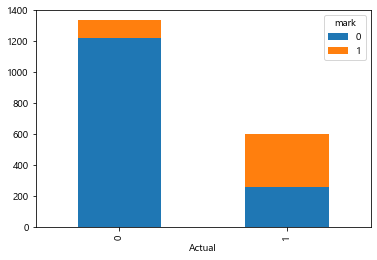

එන්න එන්න දැන් පරක්කු නෑ මුළ ටික හෙට එකෙන් අහමු ඊට පස්සේ ආයම
Predicted Label :  Not Hate  | Turth Label :  Not Hate

ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate

කන්න බොන්න දීලා කරට අත දාගෙන පිටිපස්සෙන් පිහියෙන් අනින සිස්ටම් එක තමයි පර්සි ලග තිබ්බෙ අන්තිමට පර්සි ලග හිටියා සුමනයා පර්සිටත් දුන්නෙ එවැනිම පාරක් තමයි හතර ගාතෙන් ඇදගෙන වැටෙන්න
Predicted Label :  Not Hate  | Turth Label :  Not Hate

කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate

ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Hate  | Turth Label :  Hate

මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate

සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

In [4]:
# Fasttext dynamic embedding - tranable = True - changesd architecture
TC.EPOCHS =50
TC.BATCH_SIZE =16
TC.lr = 0.0001
TC.tag = "TCN random emb lr 0.0001"
TC.trainable = True
tcn_tf_model = tcn_model(TC)
tcn_tf_model,hist = TC.train_model(tcn_tf_model)
Y_pred = TC.model_evaluate(tcn_tf_model,hist)
TC.save_predictions(Y_pred,TC.tag)

##### XLM-R Embedding